In [1]:
from keras.losses import categorical_crossentropy, sparse_categorical_crossentropy, binary_crossentropy
from keras.layers import Conv2D,MaxPooling2D,UpSampling2D,Input,BatchNormalization,Activation,Flatten
from keras.preprocessing.image import ImageDataGenerator
from sklearn.metrics import multilabel_confusion_matrix
from sklearn.preprocessing import MultiLabelBinarizer
from sklearn.model_selection import train_test_split
from keras import layers, models, optimizers
from keras.optimizers import adam, Adam
from keras.utils import to_categorical
from keras.preprocessing import image
from skimage.transform import resize
%matplotlib inline
import matplotlib.pyplot as plt
from keras import initializers
from keras import backend as K
from keras.models import Model
from keras.layers import *
from urllib import request
import tensorflow as tf
from skimage import io
from lxml import etree
from PIL import Image
from keras import *
import numpy as np
import tarfile
import keras

import glob
import sys
import cv2
import os
import re


print("TensorFlow Version : ", tf.__version__)
print("Open CV Version : ",cv2.__version__)
print("Keras Version : ", keras.__version__)

Using TensorFlow backend.


TensorFlow Version :  2.2.0
Open CV Version :  4.1.2
Keras Version :  2.3.1


In [2]:
#Here we mount the google drive to save our trained model weights
'''from google.colab import drive
drive.mount('/content/gdrive')'''

"from google.colab import drive\ndrive.mount('/content/gdrive')"

We download the PASCAL VOC 2009 dataset and save it into a local folder. The downloaded dataset is extracted into the folder **/content/sample_data/PascalVOC/**. As long as the runtime is connected, the data set will be present in the downloaded location and will be loaded into the variables. Once, the run-time gets disconnected or the Colab Notebook is closed, the dataset will be downloaded again and saved into the below mentioned folder.


In [3]:
basePath = "/content/sample_data/PascalVOC/"

if not os.path.isdir(basePath):
  os.makedirs(basePath)

pascalVOCDataSetURL = "http://host.robots.ox.ac.uk/pascal/VOC/voc2009/VOCtrainval_11-May-2009.tar"

if os.path.isfile(basePath+"VOCtrainval_11-May-2009.tar"):
  print("VOCtrainval_11-May-2009.tar already exists in the folder {}".format(basePath))
  if len(os.listdir(basePath+"VOCdevkit") ) == 0:
    print("Directory is empty")
    os.system("rm -rf /content/sample_data/VOCdevkit/")
    with tarfile.open(os.path.join(basePath, "VOCtrainval_11-May-2009.tar")) as f:
      f.extractall(os.path.join(basePath))
  else:    
    print("Data sets are already downloaded and is present in the directory {}".format(basePath))

else:
  print("Downloading file VOCtrainval_11-May-2009.tar from {}".format(pascalVOCDataSetURL))
  print("This might take few minutes !!!")
  with request.urlopen(pascalVOCDataSetURL) as r, open(os.path.join(basePath, "VOCtrainval_11-May-2009.tar"), 'wb') as f:
    f.write(r.read())
  print("Download Complete !!!")
  print("Extracting the data sets into the folder {}".format(basePath))
    # extract
  with tarfile.open(os.path.join(basePath, "VOCtrainval_11-May-2009.tar")) as f:
    f.extractall(os.path.join(basePath))
  print("Data set extraction Complete !!!")

This might take few minutes !!!
Download Complete !!!
Extracting the data sets into the folder /content/sample_data/PascalVOC/
Data set extraction Complete !!!


In [4]:
dataSetDirectory = basePath + "VOCdevkit/VOC2009/"
imgageDirectory = os.path.join(dataSetDirectory, 'JPEGImages')
annotationsDirectory = os.path.join(dataSetDirectory, 'Annotations')
segFolder = os.path.join(dataSetDirectory, 'ImageSets', 'Segmentation')
setDirectory = os.path.join(dataSetDirectory, 'ImageSets', 'Main')
annotationFiles = os.listdir(annotationsDirectory)
classesFiles = os.listdir(setDirectory)

For classification, we train the classifier on the images and the model gives the output in terms of confidence scores for each class. The input to this classifier will be a one-hot encoded vector of the labels. 

For segmentation, the models takes an image as input and outputs another image with segmented objects. Since, we are performing supervised learning, the target for a segmentation model is a segmented image with different colors. Each color is associated to a class of the object. Therefore, to train the segmentation model, it is necessary to encode the target image colors to its corresponding classes. The COLORMAP list shows the color values (RGB) for each class.

**Note:** Here the color palette for the boundary around a segmented object is not considered

In [5]:
COLORMAP = [[0,0,0], [128, 0, 0], [0, 128, 0], [128, 128, 0],
                [0, 0, 128], [128, 0, 128], [0, 128, 128], [128, 128, 128],
                [64, 0, 0], [192, 0, 0], [64, 128, 0], [192, 128, 0],
                [64, 0, 128], [192, 0, 128], [64, 128, 128], [192, 128, 128],
                [0, 64, 0], [128, 64, 0], [0, 192, 0], [128, 192, 0],
                [0, 64, 128]]
CLASSES = ['background', 'aeroplane', 'bicycle', 'bird', 'boat',
               'bottle', 'bus', 'car', 'cat', 'chair', 'cow',
               'diningtable', 'dog', 'horse', 'motorbike', 'person',
               'pottedplant', 'sheep', 'sofa', 'train', 'tvmonitor']


CM2CLASS = np.zeros(256 ** 3) # every pixel 0~255，RGB 3 channel

for i,cm in enumerate(COLORMAP):
    CM2CLASS[(cm[0] * 256 + cm[1]) * 256 + cm[2]] = i # build index

n_classes = len(CLASSES)
id2code = {k:v for k,v in enumerate(COLORMAP)}
image_size = 224

The data set images for each class are provided in a **.txt** file for training and validation images respectively. Rather than using the seperate **train.txt** and **val.txt** files, we load the complete data set using **trainval.txt** file. Every class has its own **trainval.txt**, therefore in the below cell we read all the files in on go. The dataset is later divided into train and test and validation sets from the full dataset. 

In [6]:
txtFiles = [os.path.join(setDirectory, cf) for cls in CLASSES for cf in classesFiles if cls in cf and cls+'_trainval.txt' in cf] #List all the train files


In [7]:
txtFiles

['/content/sample_data/PascalVOC/VOCdevkit/VOC2009/ImageSets/Main/aeroplane_trainval.txt',
 '/content/sample_data/PascalVOC/VOCdevkit/VOC2009/ImageSets/Main/bicycle_trainval.txt',
 '/content/sample_data/PascalVOC/VOCdevkit/VOC2009/ImageSets/Main/bird_trainval.txt',
 '/content/sample_data/PascalVOC/VOCdevkit/VOC2009/ImageSets/Main/boat_trainval.txt',
 '/content/sample_data/PascalVOC/VOCdevkit/VOC2009/ImageSets/Main/bottle_trainval.txt',
 '/content/sample_data/PascalVOC/VOCdevkit/VOC2009/ImageSets/Main/bus_trainval.txt',
 '/content/sample_data/PascalVOC/VOCdevkit/VOC2009/ImageSets/Main/car_trainval.txt',
 '/content/sample_data/PascalVOC/VOCdevkit/VOC2009/ImageSets/Main/cat_trainval.txt',
 '/content/sample_data/PascalVOC/VOCdevkit/VOC2009/ImageSets/Main/chair_trainval.txt',
 '/content/sample_data/PascalVOC/VOCdevkit/VOC2009/ImageSets/Main/cow_trainval.txt',
 '/content/sample_data/PascalVOC/VOCdevkit/VOC2009/ImageSets/Main/diningtable_trainval.txt',
 '/content/sample_data/PascalVOC/VOCdevk

**Building Classification Dataset**

The below function reads the images of a class and returns the image dataset along with its labels for classification task. 

The images are loaded as numpy arrays of type float32. The corresponding labels are given out as one-hot encoded vectors.

**Note:** Reading and loading the images into can take sometime as we are loading the full dataset.

In [8]:
def get_classification_dataset(list_of_files):
    """ build training or validation set
    :param list_of_files: list of filenames to build trainset with
    :return: tuple with x np.ndarray of shape (n_images, image_size, image_size, 3) and  y np.ndarray of shape (n_images, n_classes)
    """
    temp = []
    for f_cf in list_of_files:
        with open(f_cf) as file: #It opens the files with all the names of the files with the pictures
            lines = file.read().splitlines()
            temp.append([line.split()[0] for line in lines if int(line.split()[-1]) == 1])

    train_filter = [item for l in temp for item in l]

    image_folder = os.path.join(basePath, "VOCdevkit/VOC2009/JPEGImages/")
    image_filenames = [os.path.join(image_folder, file) for f in train_filter for file in os.listdir(image_folder) if f in file]
    x = np.array([resize(io.imread(img_f), (image_size, image_size, 3)) for img_f in image_filenames]).astype('float32')
    # changed y to an array of shape (num_examples, num_classes) with 0 if class is not present and 1 if class is present
    y_temp = []
    for tf in train_filter:
        y_temp.append([1 if tf in l else 0 for l in temp])
    y = np.array(y_temp)

    return x, y


In [9]:
print("Data set loading is in progress. This can take a while. Please be patient !!!")
X_classifier, Y_classifier = get_classification_dataset(txtFiles)
print("Data set loading is complete !!!")

Data set loading is in progress. This can take a while. Please be patient !!!
Data set loading is complete !!!


In [10]:
print('%i training images from %i classes' %(X_classifier.shape[0], Y_classifier.shape[1]))

10189 training images from 20 classes


The loaded image and label data sets for classification  has to be split into train and test sets. We use a factor of 0.15 to obtain the test set from the full dataset. Which means 85% of the full dataset is used for training and 15% will be used for testing. During training, the 85% of train data is further split into train and validation sets.

Here, we use a random seed so that the split datasets always have the same images. If this is not done, then the model performance keeps changing for each run as some images from train set can become a part of test set for a different run. The overall size of train and test sets for classifier is given in the below cell

In [11]:
np.random.seed(21)
Xtrain_class, Xtest_class, Ytrain_class, Ytest_class = train_test_split(X_classifier,Y_classifier,test_size=0.15, random_state=21)
print("Classifier Training Images Size:", Xtrain_class.shape)
print("Classifier Training Labels Size:", Ytrain_class.shape)
print("Classifier Test Images Size:", Xtest_class.shape)
print("Classifier Test Labels Size:", Ytest_class.shape)

Classifier Training Images Size: (8660, 224, 224, 3)
Classifier Training Labels Size: (8660, 20)
Classifier Test Images Size: (1529, 224, 224, 3)
Classifier Test Labels Size: (1529, 20)


The data set is huge as takes a lot of memory. If the image size is increased, the variables can take up more memory. Continuing to use the notebook like this will eventually make it crash due to compelete usage of the RAM. Therefore, once, the images are loaded into train and test variables as arrays, we will  delete the full data set variables, so that the memory is freed again. 

In the below cell we delete the X and Y variables for the classification dataset.

In [12]:
del X_classifier
del Y_classifier

Below we display some of the images and their labels

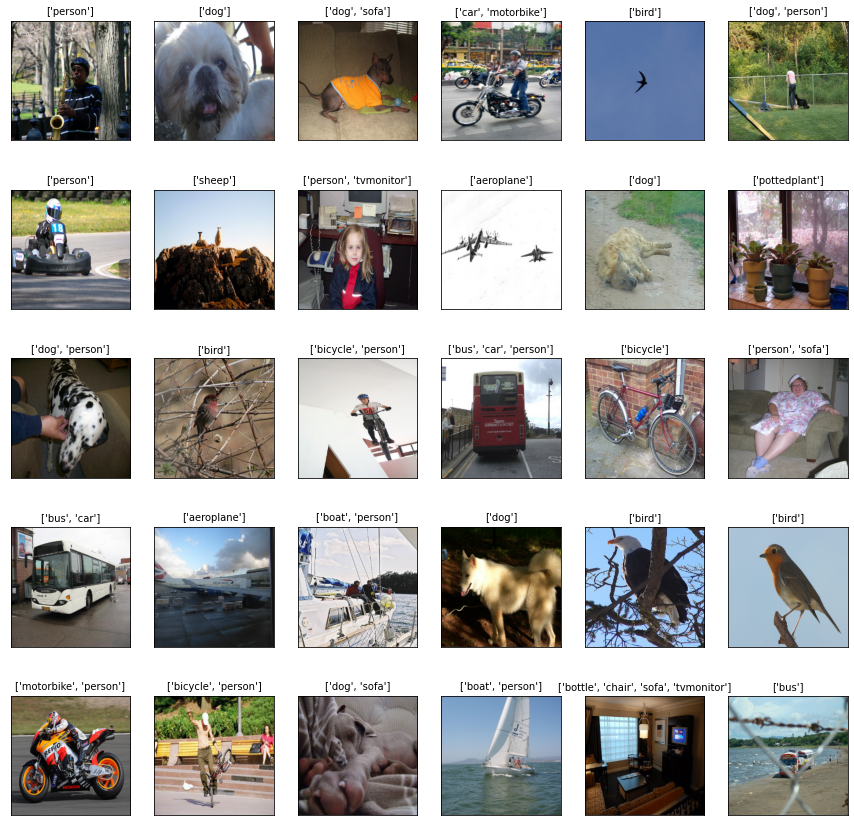

In [13]:
fig, axes = plt.subplots(5,6, figsize=(15,15), subplot_kw={'xticks':[], 'yticks':[]})
for i, ax in enumerate(axes.flat):
  str1 = [] 
  label = Ytrain_class[i] 
  ax.imshow(Xtrain_class[i])
  for idx, ele in enumerate(label):
    if ele > 0:
      str1.append(CLASSES[idx+1])
  ax.set_title("{}".format(str1), fontsize=10)

plt.show()

# 1 Supervised, end-to-end learning

##1.1 Classification

The classification tasks that we perform here is a multi-label classification. This means that a image can have multiple labels. In multi-class classification, a data sample can belong to only one class(label). Whereas in multi-label classification, one data sample can belong to multiple classes (labels). 

The classifier model takes the input as images and one-hot encoded vector lables. Unlike a multi-class classifier network, the final layer of the model should be **sigmoid** rather than softmax because the final score for each class should be independent of each other. Sigmoid converts each score of the final hidden units between 0 to 1 independent of other scores.

The below image shows an example of the final layer of the multi-label classifier.
![alt text](https://miro.medium.com/max/1400/1*VgKMR74dhQi85kLx2zLC9Q.png)

If the sigmoid scores for a class is more than 0.5, then the data is classified into that class. And there could be multiple classes having a score of more than 0.5 independently. 

**Loss function**

Since we are using a sigmoid activation function and one-hot encoded target vectors,  we use binary_crossentropy loss for training.

[Image Source and Reference:] [Multi-Label Image Classification with Neural Network ](https://towardsdatascience.com/multi-label-image-classification-with-neural-network-keras-ddc1ab1afede)

###1.1.1 Classification end-end

In the above introduction section of classification, we have seen what activation and loss functions need to be used. Here we dicuss on what backbone architecture to be used for our classifier. 

For our use case we implement a VGG16 architecture from scracth. VGG16 is a convolution neural net (CNN ) that was first used to win ILSVR(Imagenet) competition in 2014. It is considered to be one of the excellent vision model architecture till date. 

Most unique thing about VGG16 is that instead of having a large number of hyper-parameter they focused on having convolution layers of 3x3 filter with a stride 1 and always used same padding and maxpool layer of 2x2 filter of stride 2. It follows this arrangement of convolution and max pool layers consistently throughout the whole architecture. For our classifier the end layers are 1 FC(fully connected layers) followed by a sigmoid for output. The 16 in VGG16 refers to it has 16 layers that have weights.

The below image shows the VGG16 network architecture. Instead of softmax, we use a sigmod activation at the final FC layer for our classification task.

![VGG16 Network](https://miro.medium.com/max/940/1*3-TqqkRQ4rWLOMX-gvkYwA.png)

[Image Source and Reference]: [Step by step VGG16 implementation in Keras for beginners]()

In [14]:
def vgg16_model(nb_classes, input_height=224, input_width=224, hidden_dim=4096):
  model = Sequential()

  model.add(Conv2D(input_shape=(input_height,input_width,3),filters=64,kernel_size=(3,3),padding="same", activation="relu" , name='input'))
  model.add(Conv2D(filters=64,kernel_size=(3,3),padding="same", activation="relu", name='block1_conv2D_1'))
  model.add(MaxPooling2D(pool_size=(2,2),strides=(2,2), name='block1_maxpool2D_1')) 
  
  model.add(Conv2D(filters=128, kernel_size=(3,3), padding="same", activation="relu", name='block2_conv2D_1'))
  model.add(Conv2D(filters=128, kernel_size=(3,3), padding="same", activation="relu", name='block2_conv2D_2'))
  model.add(MaxPooling2D(pool_size=(2,2),strides=(2,2), name='block2_maxpool2D_1'))
  
  model.add(Conv2D(filters=256, kernel_size=(3,3), padding="same", activation="relu", name='block3_conv2D_1'))
  model.add(Conv2D(filters=256, kernel_size=(3,3), padding="same", activation="relu", name='block3_conv2D_2'))
  model.add(Conv2D(filters=256, kernel_size=(3,3), padding="same", activation="relu", name='block3_conv2D_3'))
  model.add(MaxPooling2D(pool_size=(2,2),strides=(2,2), name='block3_maxpool2D_1'))
  
  model.add(Conv2D(filters=512, kernel_size=(3,3), padding="same", activation="relu", name='block4_conv2D_1'))
  model.add(Conv2D(filters=512, kernel_size=(3,3), padding="same", activation="relu", name='block4_conv2D_2'))
  model.add(Conv2D(filters=512, kernel_size=(3,3), padding="same", activation="relu", name='block4_conv2D_3'))  
  model.add(MaxPooling2D(pool_size=(2,2),strides=(2,2), name='block4_maxpool2D_1'))
  
  model.add(Conv2D(filters=512, kernel_size=(3,3), padding="same", activation="relu", name='block5_conv2D_1'))
  model.add(Conv2D(filters=512, kernel_size=(3,3), padding="same", activation="relu", name='block5_conv2D_2'))
  model.add(Conv2D(filters=512, kernel_size=(3,3), padding="same", activation="relu", name='block5_conv2D_3'))
  model.add(MaxPooling2D(pool_size=(2,2),strides=(2,2), name='block5_maxpool2D_1'))

  model.add(Flatten())

  model.add(Dense(units=hidden_dim,activation="relu", name='fc6'))
  model.add(BatchNormalization())
  model.add(Dropout(0.5))

  model.add(Dense(units=nb_classes, activation="sigmoid", name='fc7'))

  return model

The below cell initialized and loads the VGG16 model implemented above. We use the image size as 224x224x3 for training and 512 hidden units for hidden layer fc6.

In [15]:
classifier_model_scratch =  vgg16_model(len(CLASSES)-1, image_size,image_size, 512)

The below summary shows the implemented VGG16 architecture. It can be seen that, it has 27,571,540 trainable parameters that the network has to learn from scratch using the traning images.

In [16]:
classifier_model_scratch.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input (Conv2D)               (None, 224, 224, 64)      1792      
_________________________________________________________________
block1_conv2D_1 (Conv2D)     (None, 224, 224, 64)      36928     
_________________________________________________________________
block1_maxpool2D_1 (MaxPooli (None, 112, 112, 64)      0         
_________________________________________________________________
block2_conv2D_1 (Conv2D)     (None, 112, 112, 128)     73856     
_________________________________________________________________
block2_conv2D_2 (Conv2D)     (None, 112, 112, 128)     147584    
_________________________________________________________________
block2_maxpool2D_1 (MaxPooli (None, 56, 56, 128)       0         
_________________________________________________________________
block3_conv2D_1 (Conv2D)     (None, 56, 56, 256)      

In [17]:
learning_rate = 0.0001
EPOCHS = 25

The evaluation metrics for a single class or multi label classifier can be accuracy as each data sample will have only one class, but for multi-label classifier, we use recall, precision and f1 scores.

Accuracy is straight forward and it deals with only the true positive as shown below.
![Accuracy](https://miro.medium.com/max/1026/1*JasZvEGWRoV7tsiovPK5QQ.png)

Accuracy will do a good job in the case of single or multi class, but for multi-label, we cannot compeletely rely on accuracy. We need to consider the true negative, false negatives as well. Therefore, we use the following metrices in evaluating the multi-label classifier.
Precision deals with the classification results with the actual results (TP and FP) where as recall deals with the true predictions with the predicted TP and FP. The recall and precision is as given below

![Pr-Re](https://miro.medium.com/max/1400/1*heeTAbWaKhxrGIwauXWbwA.png)

F1-score on the other hand uses both precision and recall as given below.  False positives and false negatives are crucial for a model evaluation, while true negatives are often less important to evaluate the model scores. The F1 score tries to take this into account, giving more weight to false negatives and false positives while not letting large numbers of true negatives influence the evaluation score.

![f1-score](https://miro.medium.com/max/1400/1*5_ZAlFhlCk8llhnYWD5PXw.png)

[Image Source and Reference:] [What’s the deal with Accuracy, Precision, Recall and F1?](https://towardsdatascience.com/whats-the-deal-with-accuracy-precision-recall-and-f1-f5d8b4db1021)


In [18]:
def recall_m(y_true, y_pred):
    true_positives = K.sum(K.round(K.clip(y_true * y_pred, 0, 1)))
    possible_positives = K.sum(K.round(K.clip(y_true, 0, 1)))
    recall = true_positives / (possible_positives + K.epsilon())
    return recall

def precision_m(y_true, y_pred):
    true_positives = K.sum(K.round(K.clip(y_true * y_pred, 0, 1)))
    predicted_positives = K.sum(K.round(K.clip(y_pred, 0, 1)))
    precision = true_positives / (predicted_positives + K.epsilon())
    return precision

def f1_m(y_true, y_pred):
    precision = precision_m(y_true, y_pred)
    recall = recall_m(y_true, y_pred)
    return 2*((precision*recall)/(precision+recall+K.epsilon()))

We then use a ADAM optimiser to optimize the network training and learning. The below call build the model with the optimizer, loss and the evaluation settings

In [19]:
adam = keras.optimizers.Adam(lr=learning_rate,decay=learning_rate/EPOCHS)
classifier_model_scratch.compile(loss='binary_crossentropy', optimizer=adam, metrics=['accuracy', f1_m, precision_m, recall_m])

The below cell trains our classifier with the training images and lables. Here, the parameter validation_split is used to split the train data set into train and validation sets. We use a batch size of 128 which means the model sees 128 images at a time for a epoch during training. Verbose = 1 makes the cell display the training process. Shuffle = True makes the model train on images on random order.

**Note:** The trained model weights are already saved and we don't neeed to train the model again. Therefore, the training process is commented. The model weights can be loaded and evaluated.

In [20]:
classifier_model_history = classifier_model_scratch.fit(Xtrain_class, 
                                                        Ytrain_class, 
                                                        batch_size=128, 
                                                        validation_split=(0.15), 
                                                        epochs=EPOCHS, 
                                                        verbose=1, 
                                                        shuffle = True)

Train on 7361 samples, validate on 1299 samples
Epoch 1/25
7361/7361 [==============================] - 69s 9ms/step - loss: 0.6815 - accuracy: 0.5932 - f1_m: 0.2056 - precision_m: 0.1248 - recall_m: 0.5876 - val_loss: 0.6718 - val_accuracy: 0.8953 - val_f1_m: 0.3678 - val_precision_m: 0.3886 - val_recall_m: 0.3499
Epoch 2/25
7361/7361 [==============================] - 53s 7ms/step - loss: 0.6473 - accuracy: 0.7224 - f1_m: 0.2717 - precision_m: 0.1794 - recall_m: 0.5768 - val_loss: 0.6287 - val_accuracy: 0.9125 - val_f1_m: 0.3697 - val_precision_m: 0.5081 - val_recall_m: 0.2907
Epoch 3/25
7361/7361 [==============================] - 53s 7ms/step - loss: 0.5938 - accuracy: 0.8397 - f1_m: 0.3321 - precision_m: 0.2746 - recall_m: 0.4438 - val_loss: 0.5684 - val_accuracy: 0.9125 - val_f1_m: 0.3697 - val_precision_m: 0.5081 - val_recall_m: 0.2907
Epoch 4/25
7361/7361 [==============================] - 53s 7ms/step - loss: 0.5236 - accuracy: 0.8973 - f1_m: 0.3615 - precision_m: 0.4165 - rec

Here, we plot the training curvers for the metrices and losses.

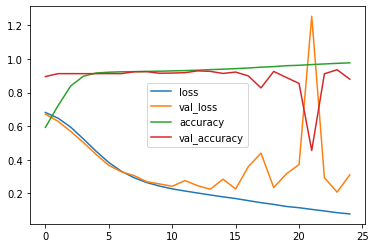

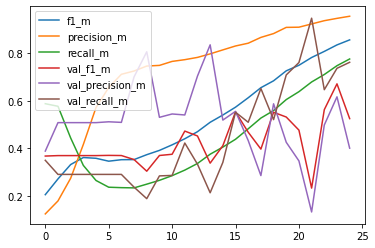

In [21]:
for key in ['loss', 'val_loss', 'accuracy', 'val_accuracy']:
    plt.plot(classifier_model_history.history[key],label=key)
plt.legend()
plt.show()

for key in ['f1_m', 'precision_m', 'recall_m','val_f1_m', 'val_precision_m', 'val_recall_m' ]:
    plt.plot(classifier_model_history.history[key],label=key)
plt.legend()
plt.show()

We then evaluate the trained model on the test set. Since, we have trained the model from scratch, the model gives an training accuracy of 81% which is rather hight compared to other evaluation metrices like f1 score and precision. This is because our dataset is imbalanced.


We have already seen that, the person class has more number of images than any other class and sheep has the least number of images. Due to the imbalance in the dataset, the overall accuracy of model is high as it consideres only the true positives. Whereas the right way of evaluation is using the other metrices and their scores shows that the model has over all performance of the model is not thay great. 

In [22]:
scores = classifier_model_scratch.evaluate(Xtest_class,Ytest_class)
print("Test set %s: %.2f%%" % (classifier_model_scratch.metrics_names[0], scores[0]*100))
print("Test set %s: %.2f%%" % (classifier_model_scratch.metrics_names[1], scores[1]*100))
print("Test set %s: %.2f%%" % (classifier_model_scratch.metrics_names[2], scores[2]*100))
print("Test set %s: %.2f%%" % (classifier_model_scratch.metrics_names[3], scores[3]*100))

1529/1529 [==============================] - 5s 3ms/step
Test set loss: 29.71%
Test set accuracy: 88.73%
Test set f1_m: 55.15%
Test set precision_m: 42.90%


In [23]:
'''save_classification_scratch_model_name = 'Classification_FromScratch_Weights.h5'
classifier_model_scratch.save_weights('/content/gdrive/My Drive/'+save_classification_scratch_model_name)'''

"save_classification_scratch_model_name = 'Classification_FromScratch_Weights.h5'\nclassifier_model_scratch.save_weights('/content/gdrive/My Drive/'+save_classification_scratch_model_name)"

We save the model weights of the classifier trained from scratch and then predict the model output on the unseen test set. Some of the predictions of the classifier is shown in below figure

In [24]:
y_pred_classifier_scratch = classifier_model_scratch.predict(Xtest_class)

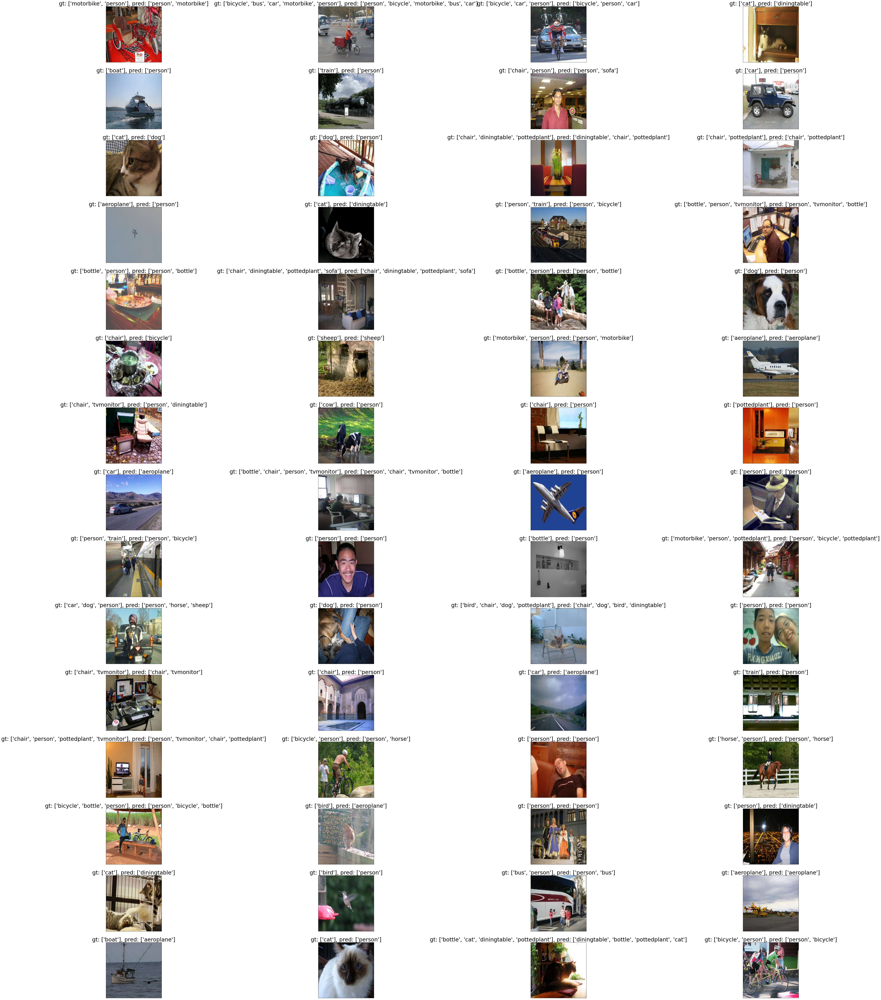

In [25]:
fig, axes = plt.subplots(15,4, figsize=(80,100), subplot_kw={'xticks':[], 'yticks':[]})
for i, ax in enumerate(axes.flat):
  str1 = []  
  str2 = []
  for idx, ele in enumerate(Ytest_class[i]):
    if ele > 0:
      str1.append(CLASSES[idx+1])

  idx2 = np.argsort(y_pred_classifier_scratch[i])[::-1][:len(str1)]
  for ix in idx2:
    str2.append(CLASSES[ix+1])
  ax.imshow(Xtest_class[i])
  ax.set_title("gt: {}, pred: {}".format(str1,str2), fontsize=30)

plt.show()

In [27]:
y_pred_class_arr = []
for y_pred_data in y_pred_classifier_scratch:
  y_pred_class = []
  for ele in y_pred_data:
    if ele > 0.4:
      y_pred_class.append(1)
    else:
      y_pred_class.append(0)
  y_pred_class_arr.append(y_pred_class)

y_pred_class_arr = np.array(y_pred_class_arr)



Here, we then calculate the confusion matrix for the model on the test set for each of the class. The below figure shows the confusion matrix. 

**Confusion Matrix:**

![confusion matrix](https://miro.medium.com/max/712/1*Z54JgbS4DUwWSknhDCvNTQ.png)

**Observation:** From the results it can be seen that most of the classes have false negatives and false positives. It is due to the imbalanced classes in the dataset. 


In [28]:
conusion_matrix_class_sratch = multilabel_confusion_matrix(y_pred_class_arr, Ytest_class)

for idx, conf_matrix in enumerate(conusion_matrix_class_sratch):
  print("Class: --> {} <-- and its Confusion Matrix : ".format(CLASSES[idx+1]))
  print(conf_matrix)
  print("\n")

Class: --> aeroplane <-- and its Confusion Matrix : 
[[1061    6]
 [ 401   61]]


Class: --> bicycle <-- and its Confusion Matrix : 
[[861   7]
 [564  97]]


Class: --> bird <-- and its Confusion Matrix : 
[[1397   54]
 [  51   27]]


Class: --> boat <-- and its Confusion Matrix : 
[[1287    9]
 [ 169   64]]


Class: --> bottle <-- and its Confusion Matrix : 
[[1312   32]
 [  92   93]]


Class: --> bus <-- and its Confusion Matrix : 
[[1291    3]
 [ 165   70]]


Class: --> car <-- and its Confusion Matrix : 
[[1285   94]
 [  19  131]]


Class: --> cat <-- and its Confusion Matrix : 
[[1415   50]
 [  18   46]]


Class: --> chair <-- and its Confusion Matrix : 
[[1207   41]
 [  69  212]]


Class: --> cow <-- and its Confusion Matrix : 
[[1494   25]
 [   8    2]]


Class: --> diningtable <-- and its Confusion Matrix : 
[[884   3]
 [527 115]]


Class: --> dog <-- and its Confusion Matrix : 
[[1366   53]
 [  39   71]]


Class: --> horse <-- and its Confusion Matrix : 
[[967  11]
 [488  63]]

###1.1.2 Classification using Transfer Learning

Deep convolutional neural network models may take days or even weeks to train on very large datasets. Transfer learning is an approach to solve a deep learning problem that focuses on applying a stored knowledge of a problem to solve a different but related problem.

Transfer learning is flexible. It is a short-cut to re-use the model weights from pre-trained models directly, as a method of feature extraction preprocessing, and can be easily integrated into entirely new models.
Top performing models can be downloaded and used directly, or integrated into a new model for any computer vision problems.


###**Traditional Learning Vs Transfer Learning:**

*   Traditional learning is isolated and occurs purely based on specific tasks, datasets and training separate isolated models on them. No knowledge is retained which can be transferred from one model to another.
*   Whereas in transfer learning, you can leverage knowledge such as features, weights etc., from previously trained models for training newer models. It is highly useful to tackle problems where there is less data for a newer task




We compare our trained classifier from scratch with a classifier trained using transfer learning. Therefore, similar to the above model we use a VGG16 backbone for this task. Here we load the imagenet weights to the VGG16 layers and freeze the network layers. We only train the final layers of the model and then evaluate the perfromance on the test set.

In [29]:
from keras.applications.vgg16 import VGG16
#load VGG16 model with weights from keras library
vgg_model = VGG16(weights="imagenet", include_top=False, input_shape=(224, 224, 3))
vgg_model.summary()

58892288/58889256 [==============================] - 1s 0us/step
Model: "vgg16"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         (None, 224, 224, 3)       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 224, 224, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 224, 224, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 112, 112, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 112, 112, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 112, 112, 128)     147584    
______________________________________________________________

In the below cell, we freeze the layers of the VGG16 with imagenet weights. We load the VGG model without the top layer. We then add the final FC (fully connected) layers as per our task requirement. In the below model summary it can be seen the the number of trainable parameters becomes lesser than the total parameters. This is due to the freezing of network layer with the weights.

In [30]:
for layer in vgg_model.layers[:-1]:
    layer.trainable = False

In [31]:
nb_class = len(CLASSES)-1
hidden_dim = 512

classifier_tl_model = models.Sequential()
classifier_tl_model.add(vgg_model)
classifier_tl_model.add(Flatten())
classifier_tl_model.add(Dense(hidden_dim, activation='relu', name='fc6'))
classifier_tl_model.add(BatchNormalization())
'''customVGGModel.add(Dense(hidden_dim, activation='relu', name='fc7'))
customVGGModel.add(BatchNormalization())'''
classifier_tl_model.add(Dropout(0.5))
classifier_tl_model.add(Dense(nb_class, activation='sigmoid', name='fc8'))

classifier_tl_model.summary()

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vgg16 (Model)                (None, 7, 7, 512)         14714688  
_________________________________________________________________
flatten_2 (Flatten)          (None, 25088)             0         
_________________________________________________________________
fc6 (Dense)                  (None, 512)               12845568  
_________________________________________________________________
batch_normalization_2 (Batch (None, 512)               2048      
_________________________________________________________________
dropout_2 (Dropout)          (None, 512)               0         
_________________________________________________________________
fc8 (Dense)                  (None, 20)                10260     
Total params: 27,572,564
Trainable params: 12,856,852
Non-trainable params: 14,715,712
_________________________________

We use the same evaluation metrices and optimizers as above from the scratch model

In [32]:
adam = keras.optimizers.Adam(lr=learning_rate,decay=learning_rate/EPOCHS)
classifier_tl_model.compile(loss='binary_crossentropy', optimizer=adam, metrics=['accuracy', f1_m, precision_m, recall_m])

We then train the classifer model with similar settings as that of the above from the scratch model. Since the initial layers are forzen, this model takes even lesser time for training compared to the above model. Also, the model performance and the metrices are better than the above from the scratch model. 

In [34]:
classifier_tl_model_history = classifier_tl_model.fit(Xtrain_class, 
                                                        Ytrain_class, 
                                                        batch_size=128, 
                                                        validation_split=(0.15), 
                                                        epochs=EPOCHS, 
                                                        verbose=1, 
                                                        shuffle = True)

Train on 7361 samples, validate on 1299 samples
Epoch 1/25
7361/7361 [==============================] - 22s 3ms/step - loss: 0.8161 - accuracy: 0.5582 - f1_m: 0.2292 - precision_m: 0.1356 - recall_m: 0.7418 - val_loss: 0.7226 - val_accuracy: 0.5971 - val_f1_m: 0.2680 - val_precision_m: 0.1592 - val_recall_m: 0.8476
Epoch 2/25
7361/7361 [==============================] - 22s 3ms/step - loss: 0.7096 - accuracy: 0.6037 - f1_m: 0.2759 - precision_m: 0.1646 - recall_m: 0.8534 - val_loss: 0.6639 - val_accuracy: 0.6095 - val_f1_m: 0.2900 - val_precision_m: 0.1725 - val_recall_m: 0.9109
Epoch 3/25
7361/7361 [==============================] - 22s 3ms/step - loss: 0.6616 - accuracy: 0.6330 - f1_m: 0.2988 - precision_m: 0.1799 - recall_m: 0.8833 - val_loss: 0.5363 - val_accuracy: 0.7367 - val_f1_m: 0.3705 - val_precision_m: 0.2339 - val_recall_m: 0.8918
Epoch 4/25
7361/7361 [==============================] - 22s 3ms/step - loss: 0.6124 - accuracy: 0.6698 - f1_m: 0.3263 - precision_m: 0.1992 - rec

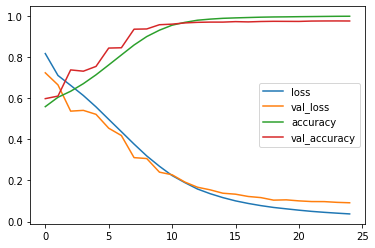

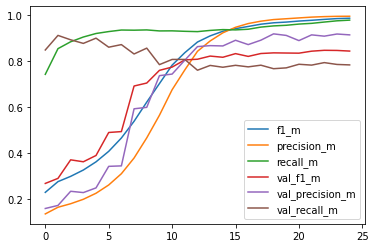

In [35]:
for key in ['loss', 'val_loss', 'accuracy', 'val_accuracy']:
    plt.plot(classifier_tl_model_history.history[key],label=key)
plt.legend()
plt.show()

for key in ['f1_m', 'precision_m', 'recall_m','val_f1_m', 'val_precision_m', 'val_recall_m' ]:
    plt.plot(classifier_tl_model_history.history[key],label=key)
plt.legend()
plt.show()

Here, we can see the model performs amazingly well with the pre-trained weights. The over all performance is very high compared to the from the scratch model.

In [36]:
scores_tl = classifier_tl_model.evaluate(Xtest_class,Ytest_class)
print("Test set %s: %.2f%%" % (classifier_tl_model.metrics_names[0], scores_tl[0]*100))
print("Test set %s: %.2f%%" % (classifier_tl_model.metrics_names[1], scores_tl[1]*100))
print("Test set %s: %.2f%%" % (classifier_tl_model.metrics_names[2], scores_tl[2]*100))
print("Test set %s: %.2f%%" % (classifier_tl_model.metrics_names[3], scores_tl[3]*100))


1529/1529 [==============================] - 4s 3ms/step
Test set loss: 8.81%
Test set accuracy: 97.66%
Test set f1_m: 85.66%
Test set precision_m: 92.20%


In [37]:
'''save_classification_tl_model_name = 'Classification_TransferLearning_Weights.h5'
classifier_tl_model.save_weights('/content/gdrive/My Drive/'+save_classification_tl_model_name)'''

"save_classification_tl_model_name = 'Classification_TransferLearning_Weights.h5'\nclassifier_tl_model.save_weights('/content/gdrive/My Drive/'+save_classification_tl_model_name)"

We then save the transfer learning weights and plot some of the predicted model outputs in the below figure.

In [38]:
y_pred_classifier_tl = classifier_tl_model.predict(Xtest_class)

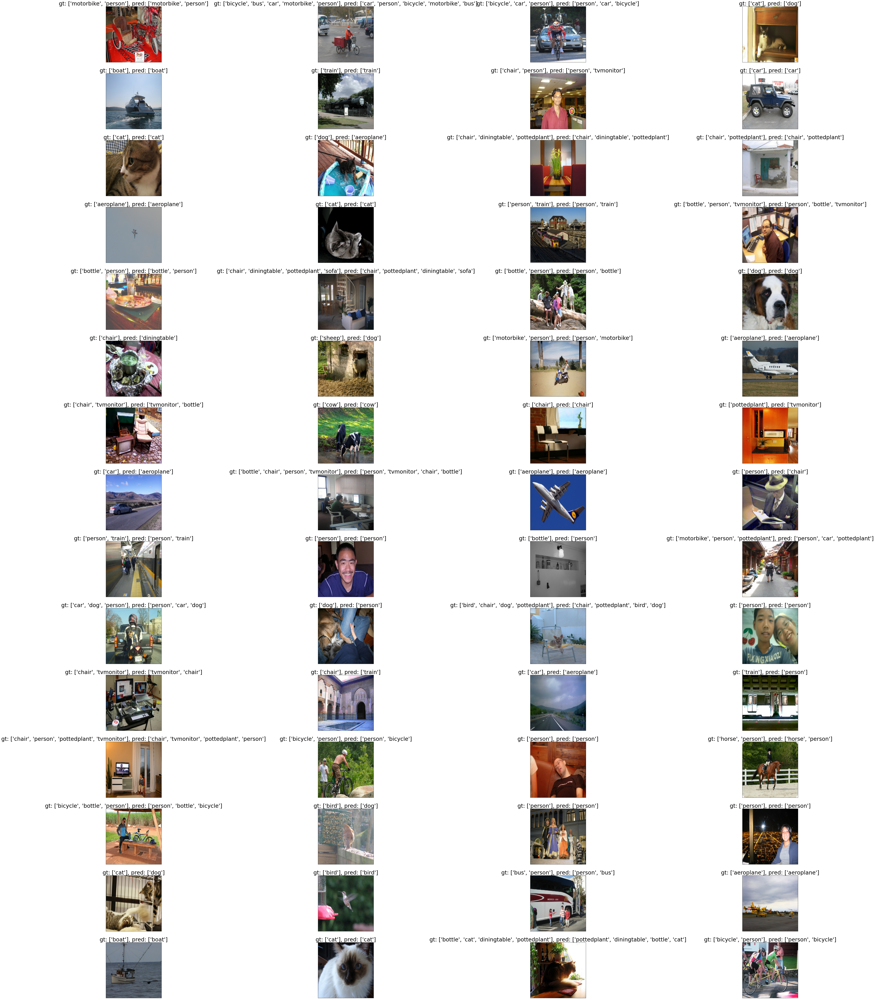

In [39]:
fig, axes = plt.subplots(15,4, figsize=(80,100), subplot_kw={'xticks':[], 'yticks':[]})
for i, ax in enumerate(axes.flat):
  str1 = []  
  str2 = []
  for idx, ele in enumerate(Ytest_class[i]):
    if ele > 0:
      str1.append(CLASSES[idx+1])

  idx2 = np.argsort(y_pred_classifier_tl[i])[::-1][:len(str1)]
  for ix in idx2:
    str2.append(CLASSES[ix+1])
  ax.imshow(Xtest_class[i])
  ax.set_title("gt: {}, pred: {}".format(str1,str2), fontsize=30)

plt.show()

In [40]:
y_pred_tl_arr = []
for y_pred_data in y_pred_classifier_tl:
  y_pred_class = []
  for ele in y_pred_data:
    if ele > 0.4:
      y_pred_class.append(1)
    else:
      y_pred_class.append(0)
  y_pred_tl_arr.append(y_pred_class)

y_pred_tl_arr = np.array(y_pred_tl_arr)

The confusion matrix shows that the model performs better for most of the classes. The dataset is still imbalance but the model does a good job in reducing the number of false positives and false negatives for few classes like **aeroplane, bird, sofa and motorbike**.

In [41]:
conusion_matrix_class_sratch = multilabel_confusion_matrix(y_pred_class_arr, Ytest_class)

for idx, conf_matrix in enumerate(conusion_matrix_class_sratch):
  print("Class: --> {} <-- and its Confusion Matrix : ".format(CLASSES[idx+1]))
  print(conf_matrix)
  print("\n")

Class: --> aeroplane <-- and its Confusion Matrix : 
[[1061    6]
 [ 401   61]]


Class: --> bicycle <-- and its Confusion Matrix : 
[[861   7]
 [564  97]]


Class: --> bird <-- and its Confusion Matrix : 
[[1397   54]
 [  51   27]]


Class: --> boat <-- and its Confusion Matrix : 
[[1287    9]
 [ 169   64]]


Class: --> bottle <-- and its Confusion Matrix : 
[[1312   32]
 [  92   93]]


Class: --> bus <-- and its Confusion Matrix : 
[[1291    3]
 [ 165   70]]


Class: --> car <-- and its Confusion Matrix : 
[[1285   94]
 [  19  131]]


Class: --> cat <-- and its Confusion Matrix : 
[[1415   50]
 [  18   46]]


Class: --> chair <-- and its Confusion Matrix : 
[[1207   41]
 [  69  212]]


Class: --> cow <-- and its Confusion Matrix : 
[[1494   25]
 [   8    2]]


Class: --> diningtable <-- and its Confusion Matrix : 
[[884   3]
 [527 115]]


Class: --> dog <-- and its Confusion Matrix : 
[[1366   53]
 [  39   71]]


Class: --> horse <-- and its Confusion Matrix : 
[[967  11]
 [488  63]]

#2 Computer Vision - A solved problem ?

##2.1 Adversarial Examples

In this section, we develop an auto encoder model and train it with the train and test sets of classification data. The output of the adversarial model is then added to the original images and using this we perform an adversarial attack on the classifier.

In the below lines of code, we implement the auto-encoder model.

In [ ]:
def upsampling_conv(input,filter,model_name,kernel_size=(3,3),sample_size=(2,2),padding="same",activation="relu"):

    upsample = UpSampling2D(sample_size,name=model_name+'_Upsample')(input)
    conv_out = Conv2D(filter,kernel_size,name=model_name+"_Conv",padding=padding,activation=activation)(upsample)
    return conv_out


def maxpool_conv(input,filter,model_name,kernel_size=(3,3),pool_size=(2,2),padding="same",activation="relu"):
    conv_out = Conv2D(filter,kernel_size,name=model_name+"_Conv",padding=padding,activation=activation)(input)
    pool_out = MaxPooling2D(pool_size,name=model_name+"_Maxpooling")(conv_out)
    return pool_out

In [ ]:
def autoEncoderModel(input_height=224, input_width=224):
  input = Input(shape=(input_height,input_width,3))
  enc1= maxpool_conv(input,3,model_name="encoder_1")
  enc2= maxpool_conv(enc1,16,model_name="encoder_2")
  enc3= maxpool_conv(enc2,32,model_name="encoder_3")

  dec1 = upsampling_conv(enc3,32,model_name="decoder_1")
  dec2 = upsampling_conv(dec1,16,model_name="decoder_2")
  dec3 = upsampling_conv(dec2,3,model_name="decoder_3")

  adv_model = Model(input,dec3)

  return adv_model

In [ ]:
def get_img_idx(y_data):
  image_index = []
  for idx, data in  enumerate(y_data):
    for it, ele in enumerate(data):
      if ((it == 0 and ele == 1) or (it == 2 and ele == 1)):
        image_index.append(idx)

  return image_index


In [ ]:
trainIndex = get_img_idx(Ytrain_class)
testIndex = get_img_idx(Ytest_class)

In [ ]:
def get_adv_data(index,mode=None):
  x = []
  y = []
  if mode=='train':
    for idx in index:
      x.append(Xtrain_class[idx].tolist())
      y.append(Ytrain_class[idx].tolist())
  else:
    for idx in index:
      x.append(Xtest_class[idx].tolist())
      y.append(Ytest_class[idx].tolist())

  return np.array(x), np.array(y)

In [ ]:
Xtrain_adv, Ytrain_adv = get_adv_data(trainIndex, 'train')
Xtest_adv, Ytest_adv = get_adv_data(testIndex, 'test')


In [ ]:
print(Xtrain_adv.shape, Ytrain_adv.shape)
print(Xtest_adv.shape, Ytest_adv.shape)


(873, 224, 224, 3) (873, 20)
(148, 224, 224, 3) (148, 20)


In [ ]:
adversarial_model_train = autoEncoderModel(image_size,image_size)
adversarial_model_test = autoEncoderModel(image_size,image_size)


In [ ]:
 adversarial_model_train.compile(loss="mean_absolute_error",optimizer="adam",metrics=["accuracy"])
 adversarial_model_test.compile(loss="mean_absolute_error",optimizer="adam",metrics=["accuracy"])


**Training Adversiary 1: Train Adversiary** 

In [ ]:
adversarial_model_train.fit(x=Xtrain_adv,y=Xtrain_adv.copy(),batch_size=32,epochs=30,validation_split=0.15)

Train on 742 samples, validate on 131 samples
Epoch 1/30
742/742 [==============================] - 5s 7ms/step - loss: 0.2906 - accuracy: 0.3026 - val_loss: 0.2079 - val_accuracy: 0.1977
Epoch 2/30
742/742 [==============================] - 4s 5ms/step - loss: 0.1282 - accuracy: 0.3125 - val_loss: 0.1045 - val_accuracy: 0.4474
Epoch 3/30
742/742 [==============================] - 4s 5ms/step - loss: 0.0853 - accuracy: 0.4909 - val_loss: 0.0813 - val_accuracy: 0.5956
Epoch 4/30
742/742 [==============================] - 4s 5ms/step - loss: 0.0679 - accuracy: 0.5821 - val_loss: 0.0660 - val_accuracy: 0.6815
Epoch 5/30
742/742 [==============================] - 4s 5ms/step - loss: 0.0600 - accuracy: 0.6408 - val_loss: 0.0625 - val_accuracy: 0.6811
Epoch 6/30
742/742 [==============================] - 4s 5ms/step - loss: 0.0579 - accuracy: 0.6667 - val_loss: 0.0612 - val_accuracy: 0.7154
Epoch 7/30
742/742 [==============================] - 4s 5ms/step - loss: 0.0557 - accuracy: 0.7104 - 

**Training Adversiary 2: Test Adversiary** 

In [ ]:
adversarial_model_test.fit(x=Xtest_adv,y=Xtest_adv.copy(),batch_size=32,epochs=30,validation_split=0.15)


Train on 125 samples, validate on 23 samples
Epoch 1/30
125/125 [==============================] - 2s 14ms/step - loss: 0.4114 - accuracy: 0.2111 - val_loss: 0.3830 - val_accuracy: 0.3159
Epoch 2/30
125/125 [==============================] - 1s 5ms/step - loss: 0.3788 - accuracy: 0.2122 - val_loss: 0.3647 - val_accuracy: 0.3154
Epoch 3/30
125/125 [==============================] - 1s 5ms/step - loss: 0.3372 - accuracy: 0.2127 - val_loss: 0.2754 - val_accuracy: 0.3164
Epoch 4/30
125/125 [==============================] - 1s 5ms/step - loss: 0.2176 - accuracy: 0.2148 - val_loss: 0.1772 - val_accuracy: 0.3161
Epoch 5/30
125/125 [==============================] - 1s 5ms/step - loss: 0.1716 - accuracy: 0.3469 - val_loss: 0.1602 - val_accuracy: 0.3158
Epoch 6/30
125/125 [==============================] - 1s 5ms/step - loss: 0.1567 - accuracy: 0.4016 - val_loss: 0.1522 - val_accuracy: 0.3184
Epoch 7/30
125/125 [==============================] - 1s 5ms/step - loss: 0.1350 - accuracy: 0.4018 - 

Creating noise for adversiary 1

In [ ]:
trainnoise = adversarial_model_train.predict(Xtrain_adv)

In [ ]:
noiseFactor = 0.2
noiseFactorTest = 0.35

In [ ]:
Xtrain_adv_noise = Xtrain_adv+noiseFactor*trainnoise

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Text(0.5, 1.0, 'Noised Image')

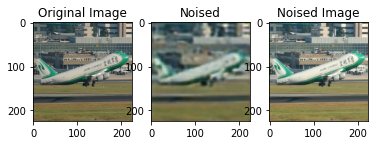

In [ ]:
plt.subplot(131)
plt.imshow(Xtrain_adv[10])
plt.title('Original Image')
plt.subplot(132)
plt.imshow(trainnoise[10])
plt.title('Noised')
plt.subplot(133)
plt.imshow(Xtrain_adv_noise[10])
plt.title('Noised Image')

As it can be seen that the noised image looks no different than original image and the noisy pertubrations is not visible to the human eyes

**Testing adversiary 1**

In [ ]:
scores_act = classifier_model_scratch.evaluate(Xtrain_adv,Ytrain_adv)
print("Actual Train set %s: %.2f%%" % (classifier_model_scratch.metrics_names[0], scores_act[0]*100))
print("Actual Train set %s: %.2f%%" % (classifier_model_scratch.metrics_names[1], scores_act[1]*100))
print("Actual Train set %s: %.2f%%" % (classifier_model_scratch.metrics_names[2], scores_act[2]*100))
print("Actual Train set %s: %.2f%%" % (classifier_model_scratch.metrics_names[3], scores_act[3]*100))

873/873 [==============================] - 9s 11ms/step
Actual Train set loss: 10.87%
Actual Train set accuracy: 97.42%
Actual Train set f1_m: 81.23%
Actual Train set precision_m: 72.32%


In [ ]:
scores_noise = classifier_model_scratch.evaluate(Xtrain_adv_noise,Ytrain_adv)
print("Noised Train set %s: %.2f%%" % (classifier_model_scratch.metrics_names[0], scores_noise[0]*100))
print("Noised Train set %s: %.2f%%" % (classifier_model_scratch.metrics_names[1], scores_noise[1]*100))
print("Noised Train set %s: %.2f%%" % (classifier_model_scratch.metrics_names[2], scores_noise[2]*100))
print("Noised Train set %s: %.2f%%" % (classifier_model_scratch.metrics_names[3], scores_noise[3]*100))

873/873 [==============================] - 8s 9ms/step
Noised Train set loss: 11.26%
Noised Train set accuracy: 97.11%
Noised Train set f1_m: 79.02%
Noised Train set precision_m: 70.11%


From the above evaluation it can be seen that our test results does not agree with what our eyes have seen. Because the number of true positive have reduce and false positive has increased as seen from f1 scores. Since we have used a low noise factor our classifier is fooled only by 1%. We can fool the classifier
to a great extent by increasing the noise factor.




**Creating noise for adversiary 2**

In [ ]:
testnnoise = adversarial_model_train.predict(Xtest_adv)
Xtest_adv_noise = Xtest_adv+noiseFactorTest*testnnoise

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Text(0.5, 1.0, 'Noised Image')

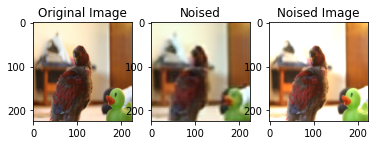

In [ ]:
plt.subplot(131)
plt.imshow(Xtest_adv[10])
plt.title('Original Image')
plt.subplot(132)
plt.imshow(testnnoise[10])
plt.title('Noised')
plt.subplot(133)
plt.imshow(Xtest_adv_noise[10])
plt.title('Noised Image')

**Testing adversiary 2**

In [ ]:
scores_act = classifier_model_scratch.evaluate(Xtest_adv,Ytest_adv)
print("Actual Test set %s: %.2f%%" % (classifier_model_scratch.metrics_names[0], scores_act[0]*100))
print("Actual Test set %s: %.2f%%" % (classifier_model_scratch.metrics_names[1], scores_act[1]*100))
print("Actual Test set %s: %.2f%%" % (classifier_model_scratch.metrics_names[2], scores_act[2]*100))
print("Actual Test set %s: %.2f%%" % (classifier_model_scratch.metrics_names[3], scores_act[3]*100))

148/148 [==============================] - 3s 23ms/step
Actual Test set loss: 20.95%
Actual Test set accuracy: 92.47%
Actual Test set f1_m: 52.17%
Actual Test set precision_m: 44.40%


In [ ]:
scores_noise = classifier_model_scratch.evaluate(Xtest_adv_noise,Ytest_adv)
print("Noise Test set %s: %.2f%%" % (classifier_model_scratch.metrics_names[0], scores_noise[0]*100))
print("Noise Test set %s: %.2f%%" % (classifier_model_scratch.metrics_names[1], scores_noise[1]*100))
print("Noise Test set %s: %.2f%%" % (classifier_model_scratch.metrics_names[2], scores_noise[2]*100))
print("Noise Test set %s: %.2f%%" % (classifier_model_scratch.metrics_names[3], scores_noise[3]*100))

148/148 [==============================] - 1s 10ms/step
Noise Test set loss: 21.88%
Noise Test set accuracy: 92.47%
Noise Test set f1_m: 50.51%
Noise Test set precision_m: 43.60%


From the above evaluation it can be seen that our test results on the test data does not agree with what our eyes have seen. Because the number of true positive have reduce and false positive has increased as seen from f1 scores. Since we have used a low noise factor our classifier is fooled only by 1%. We can fool the classifier
to a great extent by increasing the noise factor.